In [1]:
%load_ext autoreload
%autoreload 2

import pandas as pd
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from data_preparation_utils import *

## Load excel data

We use the data provided by the European Environment Agency for the years 2008-2022, corresponding to the 2d, 3d and 4th trading phases. Unfortunately, the data for the first trading phase, when the market was established, is unavailable.

Here we load the data, transform the data from wide to long format (so that each company in each observation year is a separate row). We compute some useful statistics for each year (e.g., total number of allocations over the year) and then use it to create additional fields ALLOCATION_PERCENT (proportion of total yearly allocations assigned to one company) and VERIFIED_EMISSIONS_PERCENT (proportion of total yearly verified emissions assigned to one company). We perform all the computations twice: only for Austrian companies and for the whole Europe. 

In [2]:
df_free_allowances_au = get_allocation_over_years(austrian=True)
df_free_allowances_melted_au = get_allocation_melted(df_free_allowances_au)

df_free_allowances_eu = get_allocation_over_years(austrian=False)
df_free_allowances_melted_eu = get_allocation_melted(df_free_allowances_eu)

In [3]:
df_verified_allocations_total_year_au = get_totals_by_year(df_free_allowances_melted_au)
df_verified_allocations_total_year_eu = get_totals_by_year(df_free_allowances_melted_eu)

df_free_allowances_melted_au = df_free_allowances_melted_au.merge(df_verified_allocations_total_year_au, on='year', how='left')
df_free_allowances_melted_eu = df_free_allowances_melted_eu.merge(df_verified_allocations_total_year_eu, on='year', how='left')

df_free_allowances_melted_au['ALLOCATION_PERCENT'] = df_free_allowances_melted_au['ALLOCATION_'] / df_free_allowances_melted_au['ALLOCATION_TOTAL']
df_free_allowances_melted_au['VERIFIED_EMISSIONS_PERCENT'] = df_free_allowances_melted_au['VERIFIED_EMISSIONS_'] / df_free_allowances_melted_au['VERIFIED_EMISSIONS_TOTAL']

df_free_allowances_melted_eu['ALLOCATION_PERCENT'] = df_free_allowances_melted_eu['ALLOCATION_'] / df_free_allowances_melted_eu['ALLOCATION_TOTAL']
df_free_allowances_melted_eu['VERIFIED_EMISSIONS_PERCENT'] = df_free_allowances_melted_eu['VERIFIED_EMISSIONS_'] / df_free_allowances_melted_eu['VERIFIED_EMISSIONS_TOTAL']

## Total vs allocated emissions

Here we look at the difference between total verified emissions and freely allocated emissions over the years. In the area over 0, the companies don't have enough allowances and need to compensate the difference by selling. In the area under 0, the companies have an abundance of allowances and can freely sell them. In the first trading phase, the amount of companies who could cover their emissions by free allowances and had free allowances to sell was much larger than in the following trading phases (after 2013). This is explained by the fact that in 2013, the amount of freely allocated allowances was reduced by more than 10% at once. With time, as the amount of freely allocated allowances decreases, the number of companies who have to buy the allowances to cover their emissions grows, as grows the pressure on companies to reduce their CO2 emissions. This trend is visible on both austrian and european level.

In [ ]:
fig = px.box(df_free_allowances_melted_eu, y="ALLOCATION_DIFF_", x='year', hover_data=['INSTALLATION_NAME'], title='Difference between total and allocated emissions over years, Europe')
fig.update_yaxes(title_text='Diff btw total emissions and covered emissions')
fig.add_vline(x=2012.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.add_vline(x=2020.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.show()

In [ ]:
fig = px.box(df_free_allowances_melted_au, y="ALLOCATION_DIFF_", x='year', hover_data=['INSTALLATION_NAME'], title='Difference between total and allocated emissions over years, Austria')
fig.update_yaxes(title_text='Diff btw total emissions and covered emissions')
fig.add_vline(x=2012.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.add_vline(x=2020.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.show()

## Proportion distributions
### Austria
Proportion of allocated allowances for Austrian companies, distribution. Voestalpine Stahl Linz gets the biggest amount of allocations. Voestalpine Stahl Donawitz and OMV follow. There is a drastic change in 2013 (end of the second trading phase): the difference in allocations between the companies becomes larger, the distribution becomes more widely spread.

In [4]:

fig = px.violin(df_free_allowances_melted_au, x="year", y="ALLOCATION_PERCENT", title='Free allocated allowances, proportion of Austria total allocated allowances over years', hover_data=['INSTALLATION_NAME'])	
fig.add_vline(x=2012.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.add_vline(x=2020.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.show()

Proportion of verified emissions of Austrian companies, distribution. The companies which get allocated the most allowances are the same companies which produce the most emissions. The distribtion of verified emissions normalized by total yearly emissions is more wide spread than distribution of the allocations.

In [5]:

fig = px.violin(df_free_allowances_melted_au, x="year", y="VERIFIED_EMISSIONS_PERCENT", title='Verified emissions, proportion of Austria total verified emissions over years', hover_data=['INSTALLATION_NAME'])	
fig.add_vline(x=2012.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.add_vline(x=2020.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.show()

### Europe
As expected, there are more outliers on the European market than on the Austrian market. The 2013 change is less pronounced when the whole european market is taken in the consideration. Otherwise, the trends mostly stay the same.

In [7]:

fig = px.violin(df_free_allowances_melted_eu, x="year", y="ALLOCATION_PERCENT", title='Allocated emissions, proportion of Europe total allocated emissions over years', hover_data=['INSTALLATION_NAME'])	
fig.add_vline(x=2012.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.add_vline(x=2020.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.show()

On the european market, the companies which get the most allocations and the companies which produce the most emission are different. The biggest european emission producers are energy companies, which don't get any freely allocated allowances since 2013.

In [8]:

fig = px.violin(df_free_allowances_melted_eu, x="year", y="VERIFIED_EMISSIONS_PERCENT", title='Verified emissions, proportion of Europe total verified emissions over years', hover_data=['INSTALLATION_NAME'])	
fig.add_vline(x=2012.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.add_vline(x=2020.5, line_width=3, line_dash="dash", line_color="green", annotation_text="phase switch", annotation_position="top left")
fig.show()

## Allocations and emissions vs company size
In the following part we have tried to figure out whether the number of verified emissions somehow influences the number of allocations a company gets. The idea was to check whether companies of certain size (by number of emissions) are somehow preferred by the allocation system (as it seems to be the case with the Austrian voestalpine).

In [4]:
df_free_allowances_melted_eu['COVERED_EMISSIONS'] = df_free_allowances_melted_eu['ALLOCATION_'] / df_free_allowances_melted_eu['VERIFIED_EMISSIONS_']

### Intercorrelation
Correlation between verified emissions and % of free allocated emissions:
- ALLOCATION_PERCENT - proportion of the total market allowances allocated for a company
- COVERED_EMISSIONS - proportion of the emissions of a company covered by allowances

As we can see, there is no correlation between covered emissions and verified emissions.

In [5]:
df_free_allowances_melted_eu[['VERIFIED_EMISSIONS_', 'VERIFIED_EMISSIONS_PERCENT', 'ALLOCATION_PERCENT', 'COVERED_EMISSIONS']].corr()

,VERIFIED_EMISSIONS_,VERIFIED_EMISSIONS_PERCENT,ALLOCATION_PERCENT,COVERED_EMISSIONS
VERIFIED_EMISSIONS_,1.000000,0.981350,0.537879,-0.002982
VERIFIED_EMISSIONS_PERCENT,0.981350,1.000000,0.522809,-0.002964
ALLOCATION_PERCENT,0.537879,0.522809,1.000000,0.005970
COVERED_EMISSIONS,-0.002982,-0.002964,0.005970,1.000000


## EEA size binning

Here we bin the companies by size using the categorization provided by EEA (European Environment Agency).

In [6]:
# add additional bin column based on VERIFIED_EMISSIONS
bins = [-np.inf, 0, 25000, 50000, 500000, np.inf]  # replace with your own bins
labels = ['zero', 'mini (0-25kt)', 'small (25-50kt)', 'medium (50-500kt)', 'large (>500kt)']  # replace with your own labels
df_free_allowances_melted_eu['company_size'] = pd.cut(df_free_allowances_melted_eu['VERIFIED_EMISSIONS_'], bins=bins, labels=labels)

As we can see, the large companies account for the most of the verified emissions, and that with time the total amount of verified emissions of large companies goes down significantly and somewhat goes down for middle size companies.

<Axes: title={'center': 'Total verified emissions by company size over years'}, xlabel='company_size', ylabel='verified emissions'>

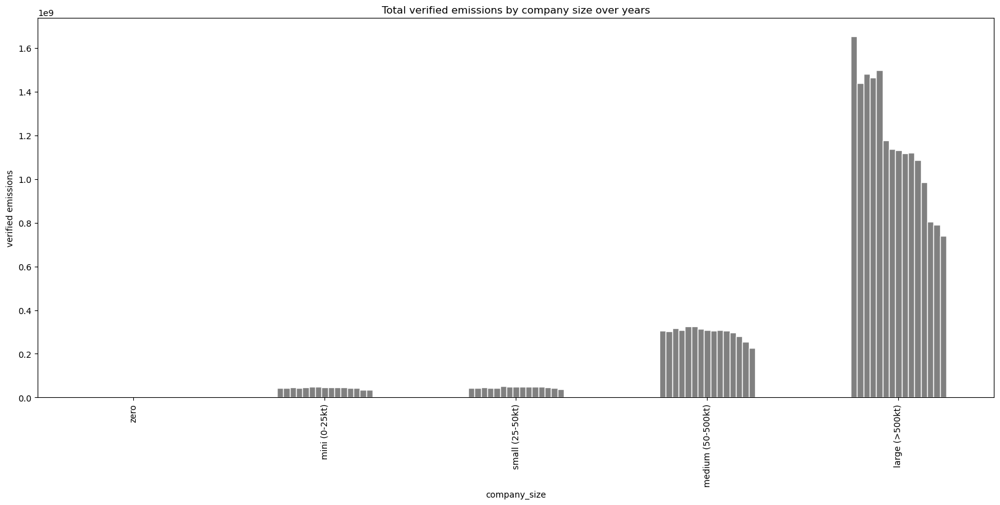

In [24]:
pivot_df = df_free_allowances_melted_eu.pivot_table(values='VERIFIED_EMISSIONS_', index='company_size', columns='year', aggfunc='sum')
pivot_df.plot(kind='bar', figsize=(20,8), title='Total verified emissions by company size over years', color='grey', edgecolor='white', linewidth=1, legend=False, ylabel='verified emissions')

Here we can see mean covered emissions for each company size over the years (each bar corresponds to a year). As we can see, the mini companies get much many more allowances than their amount of verified emissions, meaning they are very efficient in reducing their emissions and can sell most of their allocations, and with time the amount of the emissions they can sell grows. Companies of other sizes (except zero-emission companies) get less and less of their emissions covered over the years.

<Axes: title={'center': 'Mean covered emissions by company size over years (log scale)'}, xlabel='company_size', ylabel='verified emissions'>

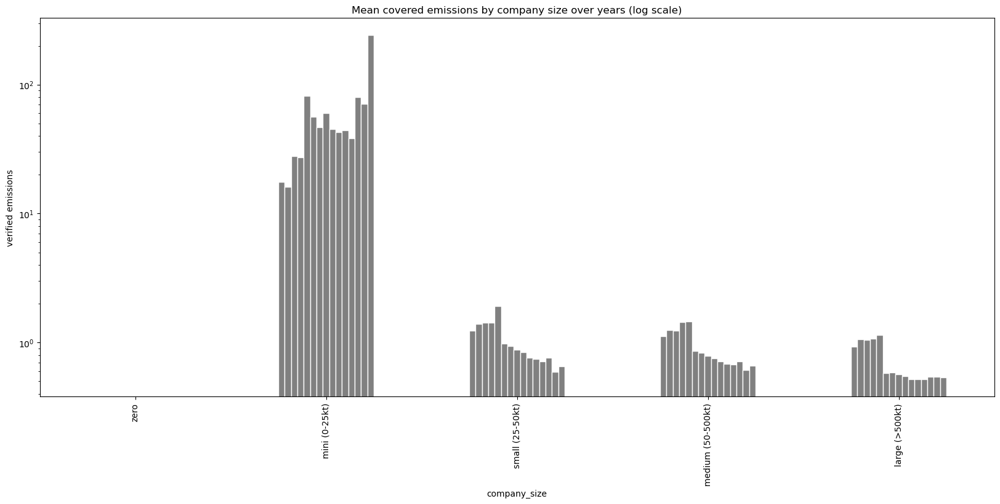

In [22]:
pivot_df = df_free_allowances_melted_eu.pivot_table(values='COVERED_EMISSIONS', index='company_size', columns='year', aggfunc='mean')
pivot_df.plot(kind='bar', figsize=(20,8), title='Mean covered emissions by company size over years (log scale)', color='grey', edgecolor='white', linewidth=1, legend=False, ylabel='covered emissions', logy=True)

But when we look at the median covered emissions instead of mean, we can see that the difference across the company sizes is much smaller. The difference in the mean plot can be attributed to the huge outliers. For an average company the amount of the emissions which are covered by free allocations decreases over the years independently from the size, but the smaller is the amount of the emissions, the bigger is the amount of covered emissions.

<Axes: title={'center': 'Median covered emissions by company size over years (log scale)'}, xlabel='company_size', ylabel='covered emissions'>

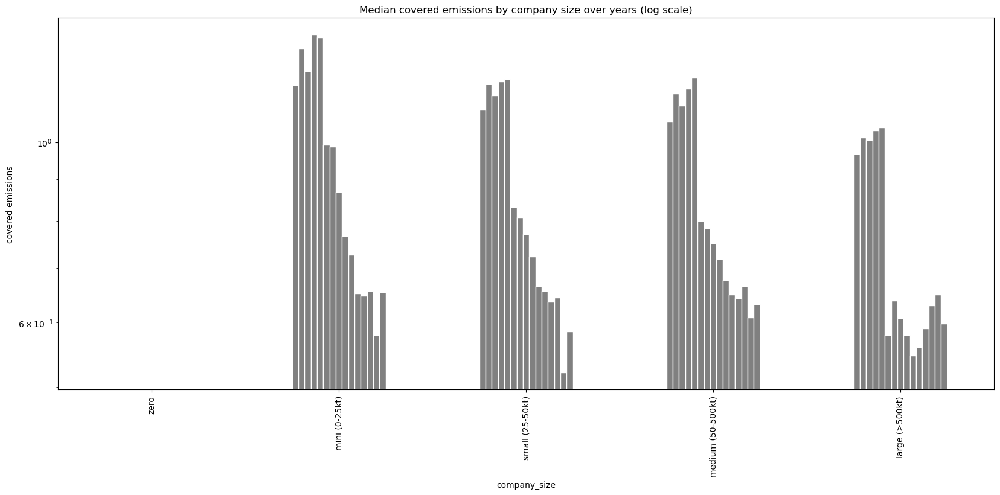

In [23]:
pivot_df = df_free_allowances_melted_eu.pivot_table(values='COVERED_EMISSIONS', index='company_size', columns='year', aggfunc='median')
pivot_df.plot(kind='bar', figsize=(20,8), title='Median covered emissions by company size over years (log scale)', color='grey', edgecolor='white', linewidth=1, legend=False, ylabel='covered emissions', logy=True)

## Percentile size binning

Divide the companies into 10 quantile-based bins of equal length based on verified emissions percent (of the market in a specific year):

In [26]:
# bin df_free_allowances_melted_eu by VERIFIED_EMISSION_PERCENT into 10 groups so that each bin contains 10% of the data
df_free_allowances_melted_eu['VERIFIED_EMISSIONS_PERCENT_BIN'] = pd.qcut(df_free_allowances_melted_eu['VERIFIED_EMISSIONS_PERCENT'], q=10, labels=[f'{i}0-{i+1}0%' for i in range(10)])

When we look at the distribution of covered emissions by company size and year, we can also see that companies with smaller amount of verified emissions get more of their emissions covered and hence have more flexibility by training.

/Users/godlinn/opt/anaconda3/envs/modsim/lib/python3.11/site-packages/numpy/lib/function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)


Text(0.5, 1.0, 'Covered emissions by verified emissions size (quantile-binned) and year')

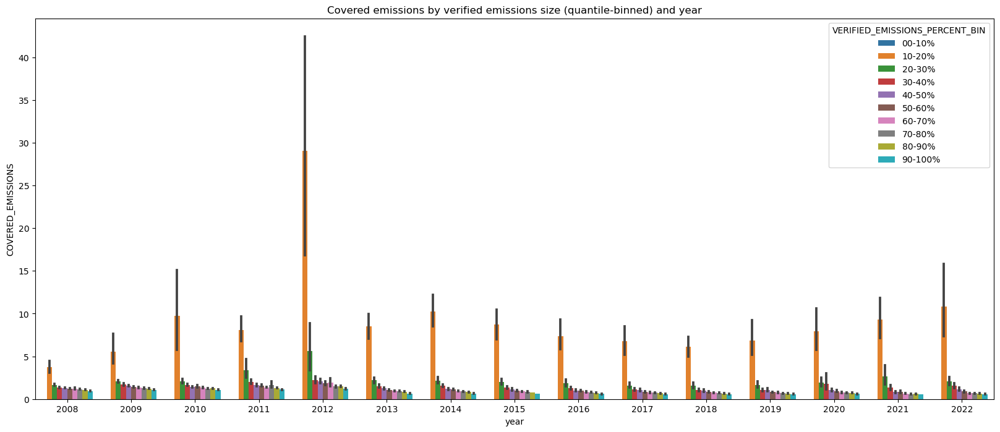

In [27]:
_, ax = plt.subplots(figsize=(20,8))
sns.barplot(data=df_free_allowances_melted_eu, x='year', y='COVERED_EMISSIONS', hue='VERIFIED_EMISSIONS_PERCENT_BIN', ax=ax)
ax.set_title('Covered emissions by verified emissions size (quantile-binned) and year')

### Voestalpine Fun Facts

As can be seen from the previous plots, Voestalpine Stahl Linz has the biggest difference between allocated and verified emissions, gets the biggest amount of allocated emissions and is responsible for the biggest amount of verified emissions in Austria. But there are multiple companies under the name of Voestalpine (Linz, Donawitz, etc.). Let's see what % of the total Austria's allowances and emissions can be attributed by Voestalpine companies. 

As can be seen, the % of national free allocated and produced CO2 emissions belonging to voestalpine grows from 20-25 to 40-45% over the last decade:

In [ ]:
df_free_allowances_melted_au['INSTALLATION_NAME'] = df_free_allowances_melted_au.INSTALLATION_NAME.astype(str) + ''
df_free_allowances_melted_au[df_free_allowances_melted_au.INSTALLATION_NAME.str.contains('oestalpine')].groupby('year')[['ALLOCATION_', 'VERIFIED_EMISSIONS_']].sum() / df_free_allowances_melted_au.groupby('year')[['ALLOCATION_', 'VERIFIED_EMISSIONS_']].sum()

## EU ETS Allowance Price
Here we plot the price of EU ETS allowances over the years:

/Users/godlinn/opt/anaconda3/envs/modsim/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/godlinn/opt/anaconda3/envs/modsim/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


[Text(0.5, 1.0, 'EU ETC price over years')]

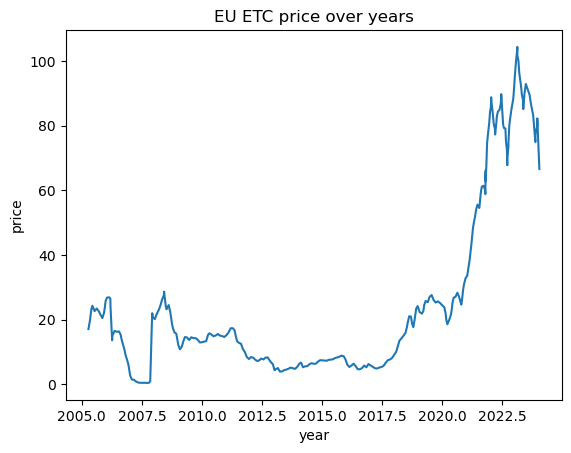

In [3]:
df_price = pd.read_csv('./data/price_data_eu_ets.csv', sep=';')
ax=sns.lineplot(data=df_price, x='year', y='price')
ax.set(title='EU ETC price over years')